<a href="https://colab.research.google.com/github/freefrit/project-metric_learning/blob/main/OnlineProducts_MetricLossOnly_LiftedStructureLoss.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Install the necessary packages

In [1]:
!pip install -q pytorch-metric-learning[with-hooks]
!pip install umap-learn

     |████████████████████████████████| 112kB 8.4MB/s 
     |████████████████████████████████| 89.7MB 38kB/s 
     |████████████████████████████████| 81kB 6.2MB/s 
     |████████████████████████████████| 1.2MB 19.5MB/s 
  Created wheel for umap-learn: filename=umap_learn-0.5.1-cp37-none-any.whl size=76569 sha256=01c435cf16509c44023cf1ac013481f8358adb265c02b26d47ac35f1ad637708
  Stored in directory: /root/.cache/pip/wheels/ad/df/d5/a3691296ff779f25cd1cf415a3af954b987fb53111e3392cf4
  Created wheel for pynndescent: filename=pynndescent-0.5.2-cp37-none-any.whl size=51362 sha256=5df9c49ca97f18a25a4a3ea5f9631080333c549a8196ccf3e1cbf2ac804d9000
  Stored in directory: /root/.cache/pip/wheels/ba/52/4e/4c28d04d144a28f89e2575fb63628df6e6d49b56c5ddd0c74e
Successfully built umap-learn pynndescent


## Import the packages

In [2]:
# Packages for pytorch metric learning
%matplotlib inline
from pytorch_metric_learning import losses, miners, samplers, trainers, testers
from pytorch_metric_learning.utils import common_functions
import pytorch_metric_learning.utils.logging_presets as logging_presets
from pytorch_metric_learning.utils.accuracy_calculator import AccuracyCalculator
import numpy as np
import torchvision
from torchvision import datasets, transforms
import torch
import torch.nn as nn
from PIL import Image
import logging
import matplotlib.pyplot as plt
import umap
from cycler import cycler
import record_keeper
import pytorch_metric_learning
logging.getLogger().setLevel(logging.INFO)
logging.info("VERSION %s"%pytorch_metric_learning.__version__)

# Packages for preparing dataset
import json
from torch.utils.data import Dataset, DataLoader

# Packages for lmporting data from google drive
from google.colab import drive
import os
drive.mount('/content/gdrive')
root = '/content/gdrive/My Drive/Stanford_Online_Products'

INFO:root:VERSION 0.9.99


Mounted at /content/gdrive


## Simple model def

In [3]:
class MLP(nn.Module):
    # layer_sizes[0] is the dimension of the input
    # layer_sizes[-1] is the dimension of the output
    def __init__(self, layer_sizes, final_relu=False):
        super().__init__()
        layer_list = []
        layer_sizes = [int(x) for x in layer_sizes]
        num_layers = len(layer_sizes) - 1
        final_relu_layer = num_layers if final_relu else num_layers - 1
        for i in range(len(layer_sizes) - 1):
            input_size = layer_sizes[i]
            curr_size = layer_sizes[i + 1]
            if i < final_relu_layer:
                layer_list.append(nn.ReLU(inplace=False))
            layer_list.append(nn.Linear(input_size, curr_size))
        self.net = nn.Sequential(*layer_list)
        self.last_linear = self.net[-1]

    def forward(self, x):
        return self.net(x)

## Initialize models, optimizers and image transforms

In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Set trunk model and replace the softmax layer with an identity function
trunk = torchvision.models.resnet50(pretrained=True)
trunk_output_size = trunk.fc.in_features
trunk.fc = common_functions.Identity()
trunk = torch.nn.DataParallel(trunk.to(device))

# Set embedder model. This takes in the output of the trunk and outputs 32 dimensional embeddings
embedder = torch.nn.DataParallel(MLP([trunk_output_size, 32]).to(device))

# Set optimizers
trunk_optimizer = torch.optim.Adam(trunk.parameters(), lr=0.00001, weight_decay=0.0001)
embedder_optimizer = torch.optim.Adam(embedder.parameters(), lr=0.0001, weight_decay=0.0001)

# Set the image transforms
train_transform = transforms.Compose([transforms.Resize(32),
                                      transforms.RandomResizedCrop(scale=(0.16, 1), ratio=(0.75, 1.33), size=32),
                                      transforms.RandomHorizontalFlip(0.5),                    
                                      transforms.ToTensor(),
                                      transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                                      ])
# train_transform = transforms.Compose([transforms.Resize(32),
#                                     transforms.RandomResizedCrop(scale=(0.16, 1), ratio=(0.75, 1.33), size=32),
#                                     transforms.RandomHorizontalFlip(0.5),
#                                     transforms.ToTensor(),
#                                     transforms.Normalize([0.5], [0.5])])
# origin: transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])

val_transform = transforms.Compose([transforms.Resize(32),
                                    transforms.CenterCrop(32),
                                    transforms.ToTensor(),
                                    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
                                    ])


Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.cache/torch/hub/checkpoints/resnet50-19c8e357.pth


## Create the dataset

In [5]:
class OnlineProducts_datasets_in_CIFAR(Dataset):
  def __init__(self, root, train = True, transform = None):
    """
    Dataset Init-Function.
    Args:
        root: the root of the dataset.
        train: declear that the dataset is training or testing.
        transform: the image transform mode you have to set before.
    Returns:
        Nothing!
    """
    super(OnlineProducts_datasets_in_CIFAR, self).__init__()
    self.train = train
    self.transform = transform

    # if training, load the training annotation file, else load the testing one.
    # the .json file stores the info of annotation in dict shape: 
    #   {'image': filenames, 'label': annotations} where filenames and annotations are arrays.
    if self.train:
      file_annotation = root + '/annotations/OnlineProducts_train_new.json'
    else:
      file_annotation = root + '/annotations/OnlineProducts_test_new.json'
    self.img_folder = root + '/images/'

    # read the file and check if the length of filenames and annotations are same.
    fp = open(file_annotation,'r')
    data_dict = json.load(fp)
    assert len(data_dict['image']) == len(data_dict['label'])
    num_data = len(data_dict['image'])
    fp.close()

    # put the filenames into self.datanames, their annotations into self.targets.
    self.datanames = []
    self.targets = []
    for i in range(num_data):
      self.datanames.append(data_dict['image'][i])
      self.targets.append(data_dict['label'][i])

  def __getitem__(self, index):
    """
    Dataset Getitem-Function.
    Returns:
        img: the data image.
        target: the label num of the data. 
    """
    img_path = self.img_folder + self.datanames[index]
    target = self.targets[index]
    # img = plt.imread(img_path)
    img = Image.open(img_path)
    img = img.convert("RGB")
    
    if self.transform is not None:
      img = self.transform(img)
    # img = img.reshape((3, 32, 32))
    
    # target = np.argmax(target, axis = 0)

    return img, target

  def __len__(self):
        return len(self.datanames)

In [6]:
my_root = '/content/gdrive/My Drive/Stanford_Online_Products'

# Create the original datasets
train_dataset = OnlineProducts_datasets_in_CIFAR(root = my_root, train = True, transform = train_transform)
val_dataset = OnlineProducts_datasets_in_CIFAR(root = my_root, train = False, transform = val_transform)
                                                
# assert set(train_dataset.targets).isdisjoint(set(val_dataset.targets))                                                _transform)

## Create the loss, miner, sampler, and package them into dictionaries

In [7]:
# Set the loss function
loss = losses.LiftedStructureLoss(neg_margin=1, pos_margin=0)

# Set the mining function
miner = miners.MultiSimilarityMiner(epsilon=0.1)

# Set the dataloader sampler
sampler = samplers.MPerClassSampler(train_dataset.targets, m=4, length_before_new_iter=len(train_dataset))

# Set other training parameters
batch_size = 32
num_epochs = 200

# Package the above stuff into dictionaries.
models = {"trunk": trunk, "embedder": embedder}
optimizers = {"trunk_optimizer": trunk_optimizer, "embedder_optimizer": embedder_optimizer}
loss_funcs = {"metric_loss": loss}
mining_funcs = {"tuple_miner": miner}

In [8]:
# Remove logs if you want to train with new parameters
!rm -rf example_logs/ example_saved_models/ example_tensorboard/

## Create the training and testing hooks

In [9]:
record_keeper, _, _ = logging_presets.get_record_keeper("example_logs", "example_tensorboard")
hooks = logging_presets.get_hook_container(record_keeper)
dataset_dict = {"val": val_dataset}
model_folder = "example_saved_models"

def visualizer_hook(umapper, umap_embeddings, labels, split_name, keyname, *args):
    logging.info("UMAP plot for the {} split and label set {}".format(split_name, keyname))
    label_set = np.unique(labels)
    num_classes = len(label_set)
    fig = plt.figure(figsize=(20,15))
    plt.gca().set_prop_cycle(cycler("color", [plt.cm.nipy_spectral(i) for i in np.linspace(0, 0.9, num_classes)]))
    for i in range(num_classes):
        idx = labels == label_set[i]
        plt.plot(umap_embeddings[idx, 0], umap_embeddings[idx, 1], ".", markersize=1)   
    plt.show()

# Create the tester
tester = testers.GlobalEmbeddingSpaceTester(end_of_testing_hook = hooks.end_of_testing_hook, 
                                            visualizer = umap.UMAP(), 
                                            visualizer_hook = visualizer_hook,
                                            dataloader_num_workers = 32,
                                            accuracy_calculator=AccuracyCalculator(k=600))

end_of_epoch_hook = hooks.end_of_epoch_hook(tester, 
                                            dataset_dict, 
                                            model_folder, 
                                            test_interval = 1,
                                            patience = 1)

## Create the trainer

In [10]:
trainer = trainers.MetricLossOnly(models,
                                optimizers,
                                batch_size,
                                loss_funcs,
                                mining_funcs,
                                train_dataset,
                                sampler=sampler,
                                dataloader_num_workers = 32,
                                end_of_iteration_hook = hooks.end_of_iteration_hook,
                                end_of_epoch_hook = end_of_epoch_hook)

## Start Tensorboard
(Turn off adblock and other shields)

In [11]:
%load_ext tensorboard
%tensorboard --logdir example_tensorboard

<IPython.core.display.Javascript object>

## Train the model

INFO:PML:Initializing dataloader
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
INFO:PML:Initializing dataloader iterator
INFO:PML:Done creating dataloader iterator
INFO:PML:TRAINING EPOCH 1
total_loss=10.76032: 100%|██████████| 1860/1860 [10:36<00:00,  2.92it/s]
INFO:PML:Evaluating epoch 1
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [11:38<00:00,  2.71it/s]
INFO:PML:Running UMAP on the val set
INFO:PML:Finished UMAP
INFO:root:UMAP plot for the val split and label set UMAP_level0


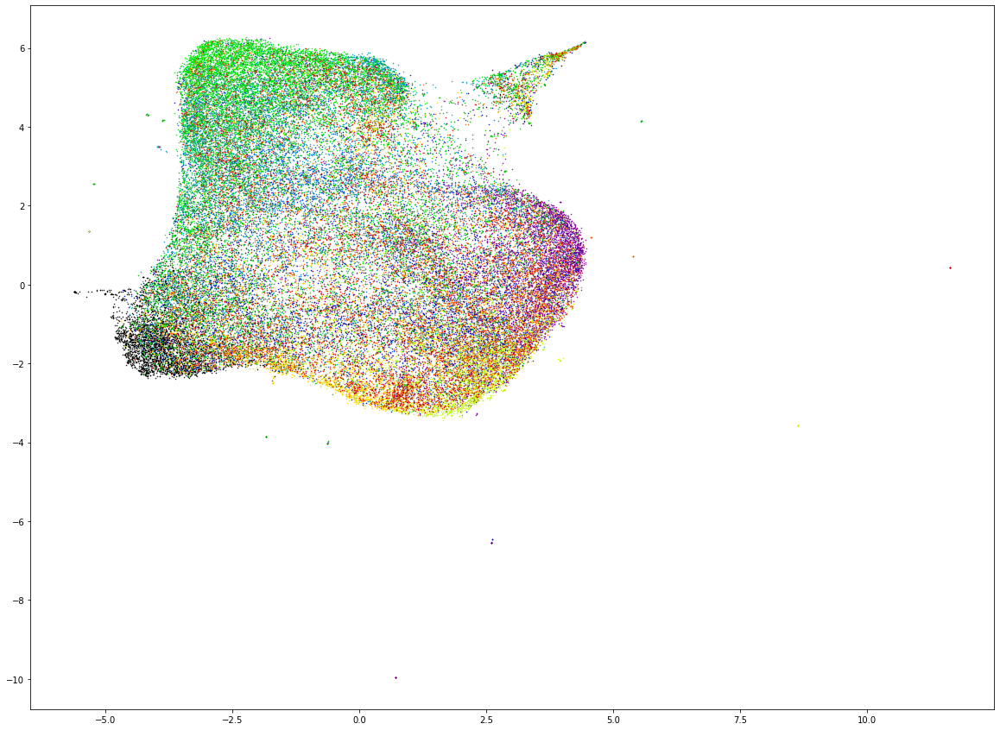

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.12231548642409384
INFO:PML:TRAINING EPOCH 2
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.87384: 100%|██████████| 1860/1860 [05:31<00:00,  5.62it/s]
INFO:PML:Evaluating epoch 2
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:23<00:00,  9.28it/s]
INFO:PML:Run

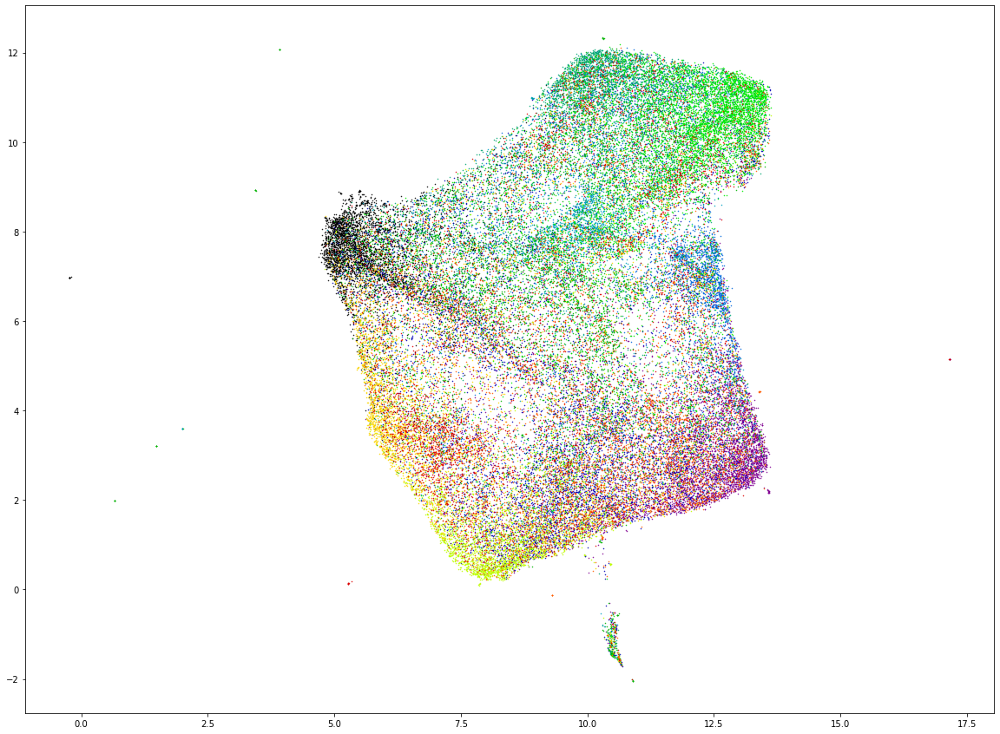

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.1743439235289254
INFO:PML:TRAINING EPOCH 3
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.11213: 100%|██████████| 1860/1860 [05:39<00:00,  5.48it/s]
INFO:PML:Evaluating epoch 3
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:29<00:00,  9.03it/s]
INFO:PML:Run

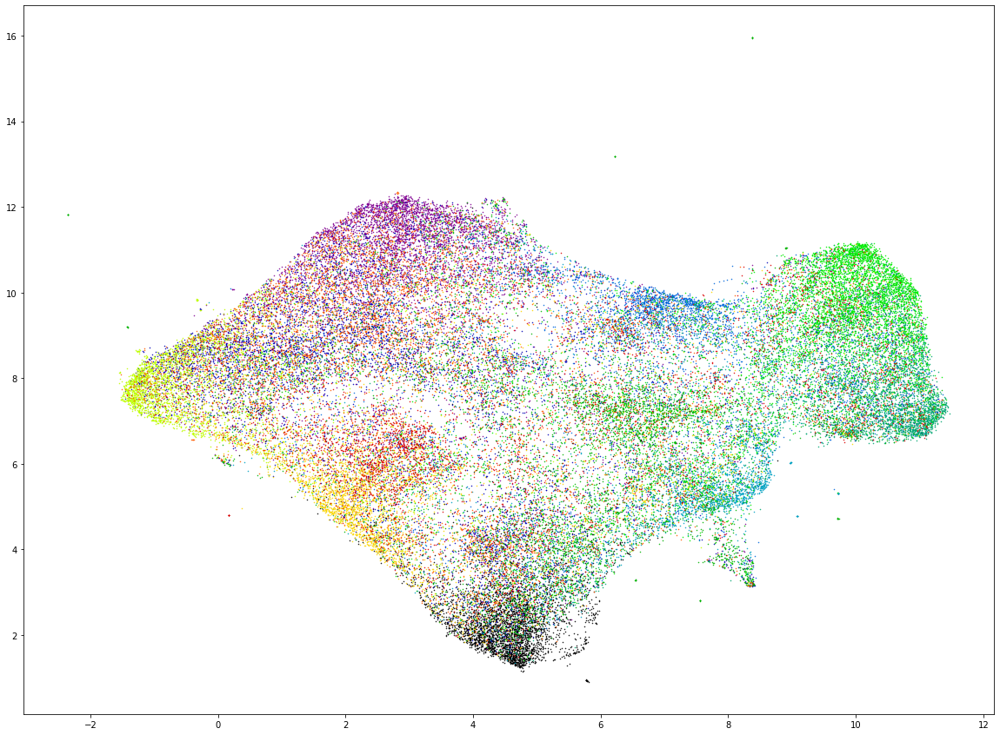

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.2183045724394001
INFO:PML:TRAINING EPOCH 4
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.84911: 100%|██████████| 1860/1860 [05:38<00:00,  5.49it/s]
INFO:PML:Evaluating epoch 4
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:33<00:00,  8.85it/s]
INFO:PML:Runn

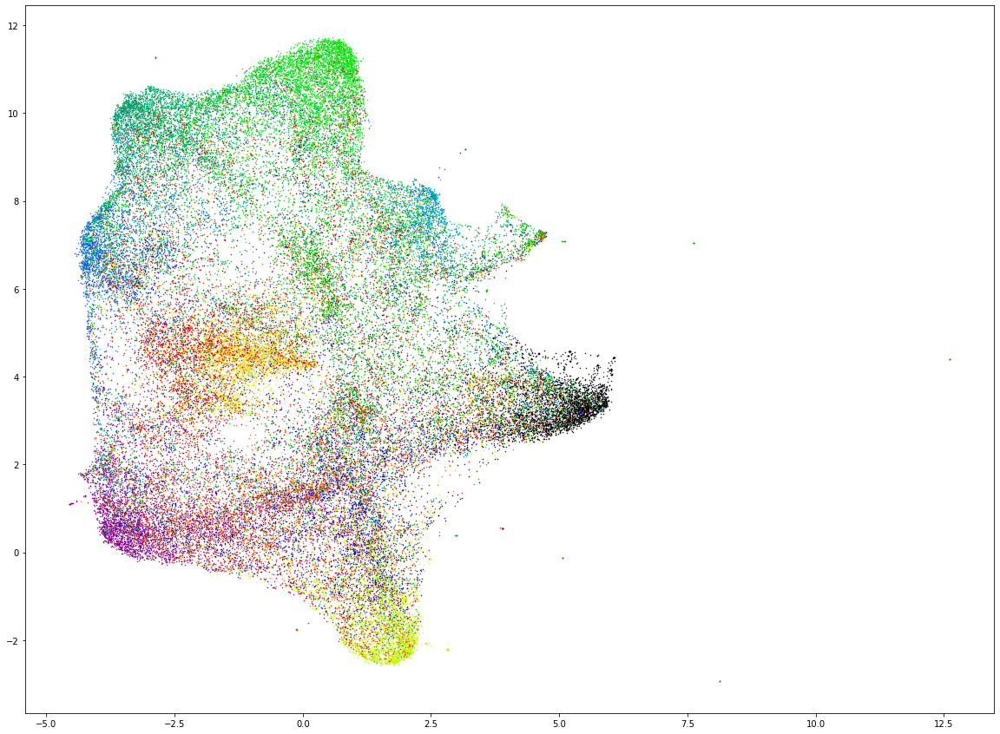

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.24903838833746922
INFO:PML:TRAINING EPOCH 5
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=11.13061: 100%|██████████| 1860/1860 [05:54<00:00,  5.25it/s]
INFO:PML:Evaluating epoch 5
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:36<00:00,  8.72it/s]
INFO:PML:Ru

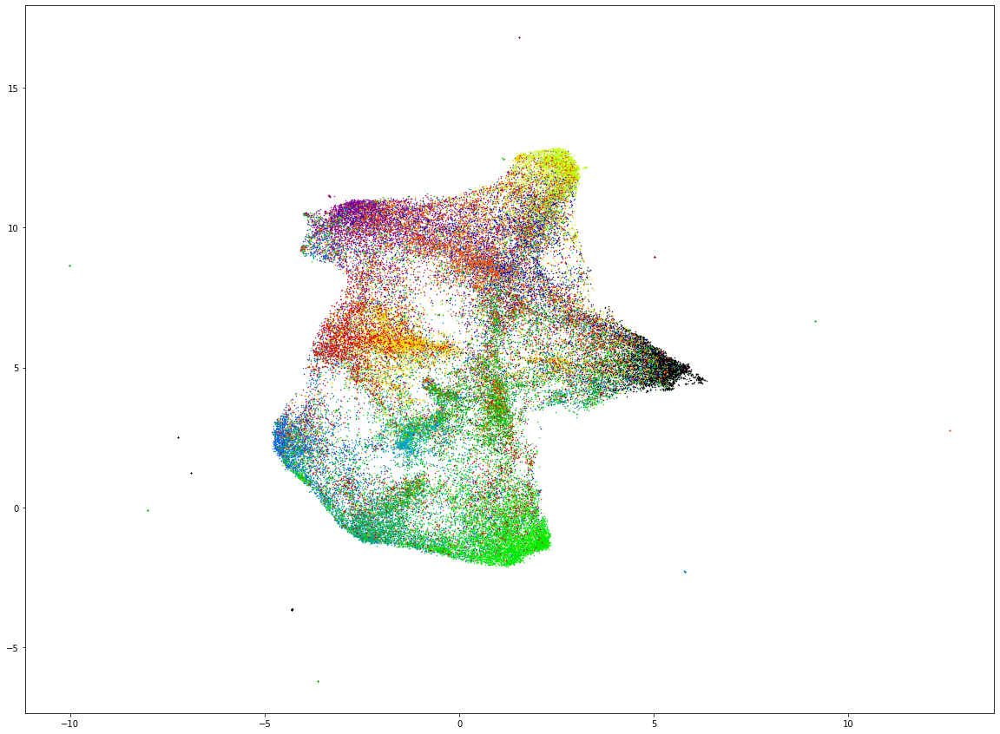

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.2733506006458078
INFO:PML:TRAINING EPOCH 6
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.42055: 100%|██████████| 1860/1860 [06:04<00:00,  5.10it/s]
INFO:PML:Evaluating epoch 6
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:40<00:00,  8.58it/s]
INFO:PML:Run

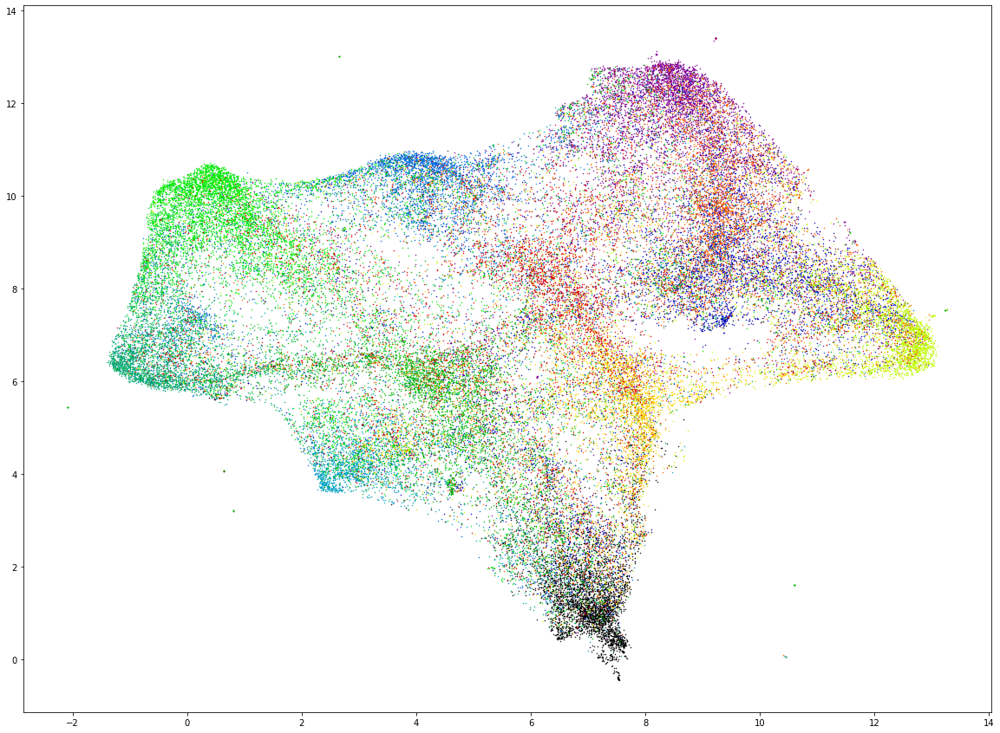

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.2924411609362661
INFO:PML:TRAINING EPOCH 7
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.43186: 100%|██████████| 1860/1860 [06:17<00:00,  4.93it/s]
INFO:PML:Evaluating epoch 7
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:45<00:00,  8.40it/s]
INFO:PML:Runn

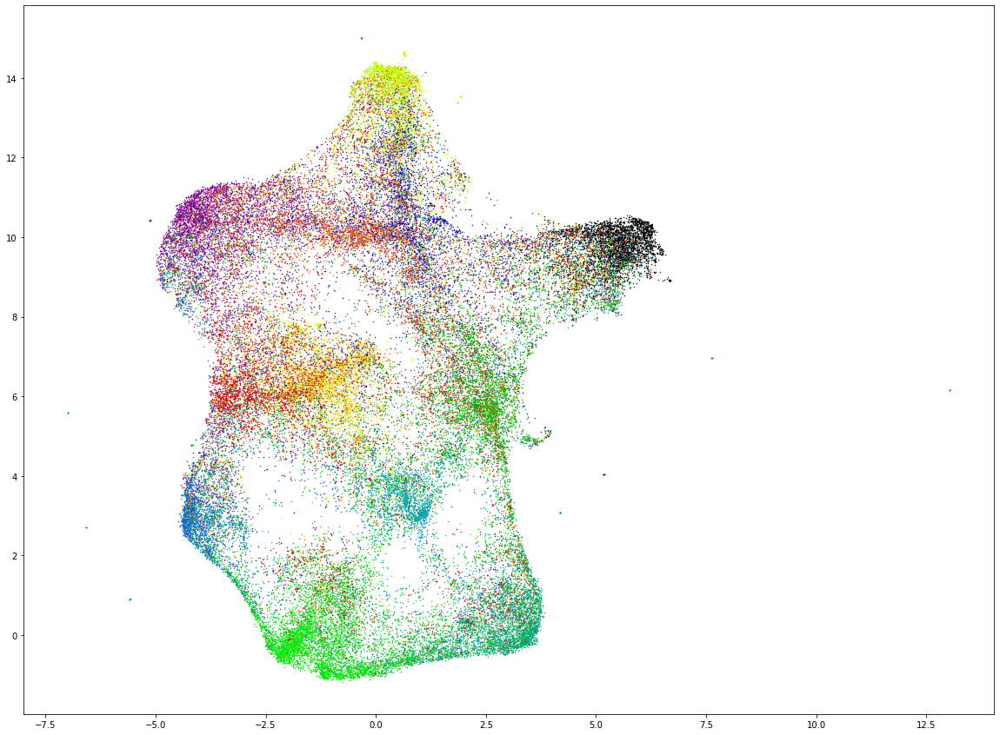

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.31012093320862677
INFO:PML:TRAINING EPOCH 8
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.86509: 100%|██████████| 1860/1860 [06:33<00:00,  4.72it/s]
INFO:PML:Evaluating epoch 8
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:50<00:00,  8.21it/s]
INFO:PML:Ru

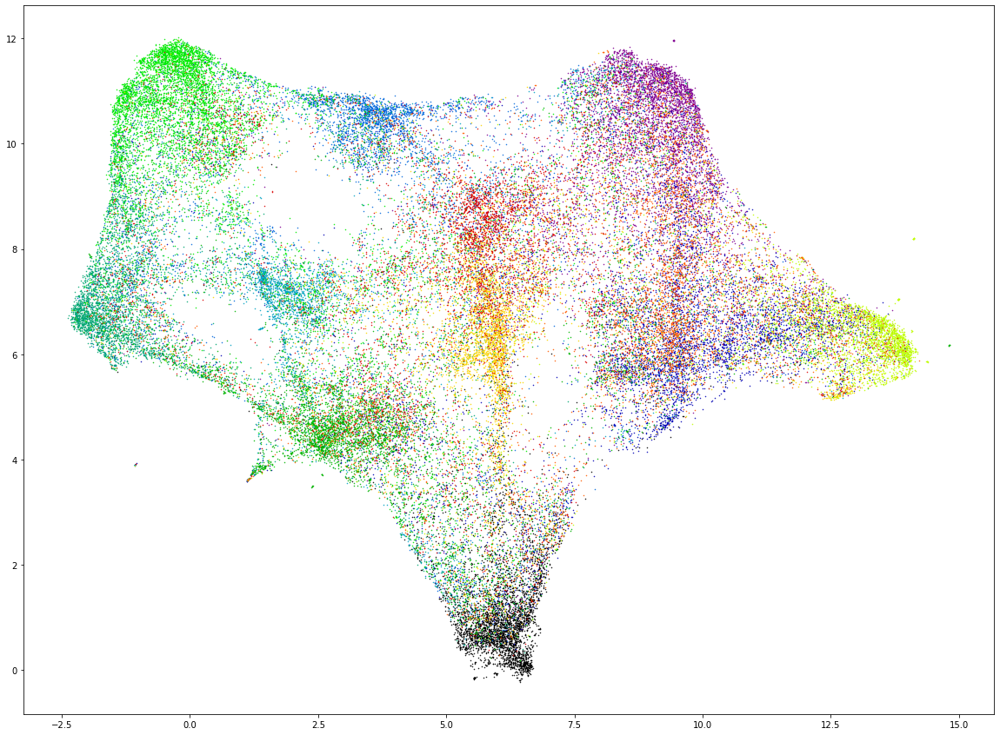

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3205736061700827
INFO:PML:TRAINING EPOCH 9
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.65680: 100%|██████████| 1860/1860 [06:53<00:00,  4.50it/s]
INFO:PML:Evaluating epoch 9
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:52<00:00,  8.12it/s]
INFO:PML:Runn

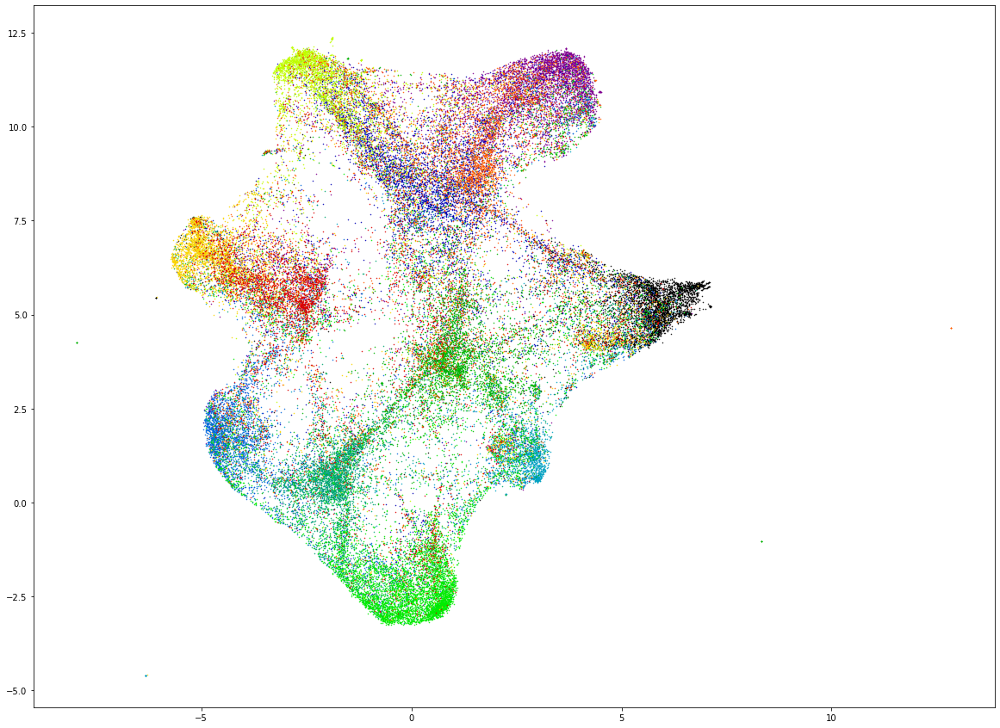

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3346544839616082
INFO:PML:TRAINING EPOCH 10
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.05259: 100%|██████████| 1860/1860 [07:03<00:00,  4.39it/s]
INFO:PML:Evaluating epoch 10
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [03:56<00:00,  8.01it/s]
INFO:PML:Ru

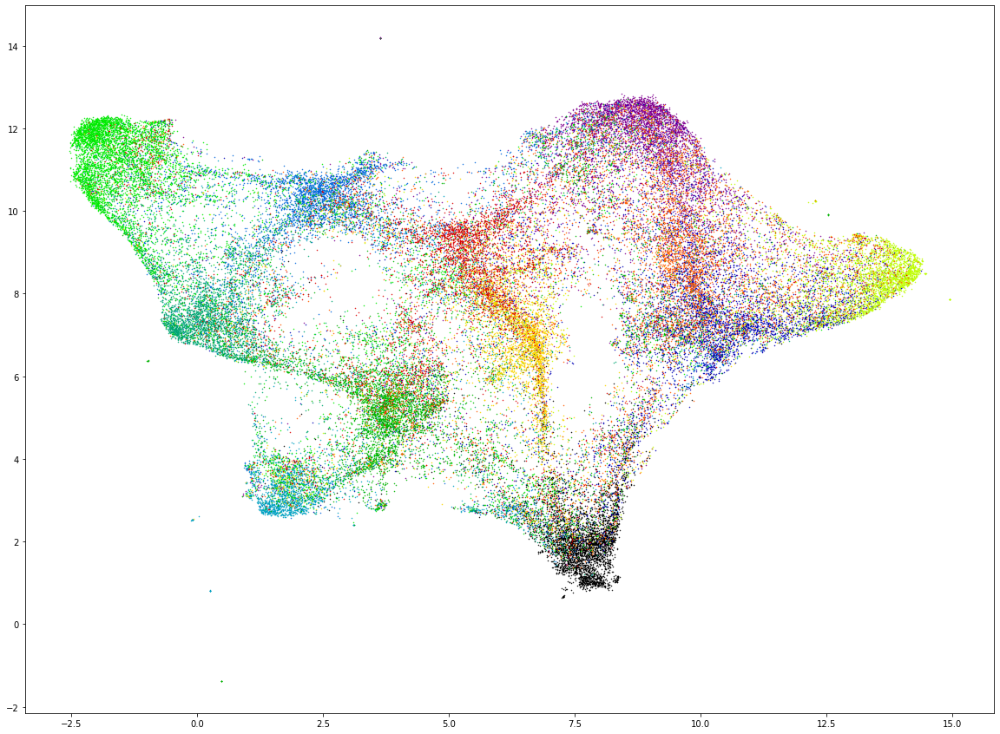

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3460426676568045
INFO:PML:TRAINING EPOCH 11
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.97205: 100%|██████████| 1860/1860 [07:18<00:00,  4.24it/s]
INFO:PML:Evaluating epoch 11
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:02<00:00,  7.80it/s]
INFO:PML:Ru

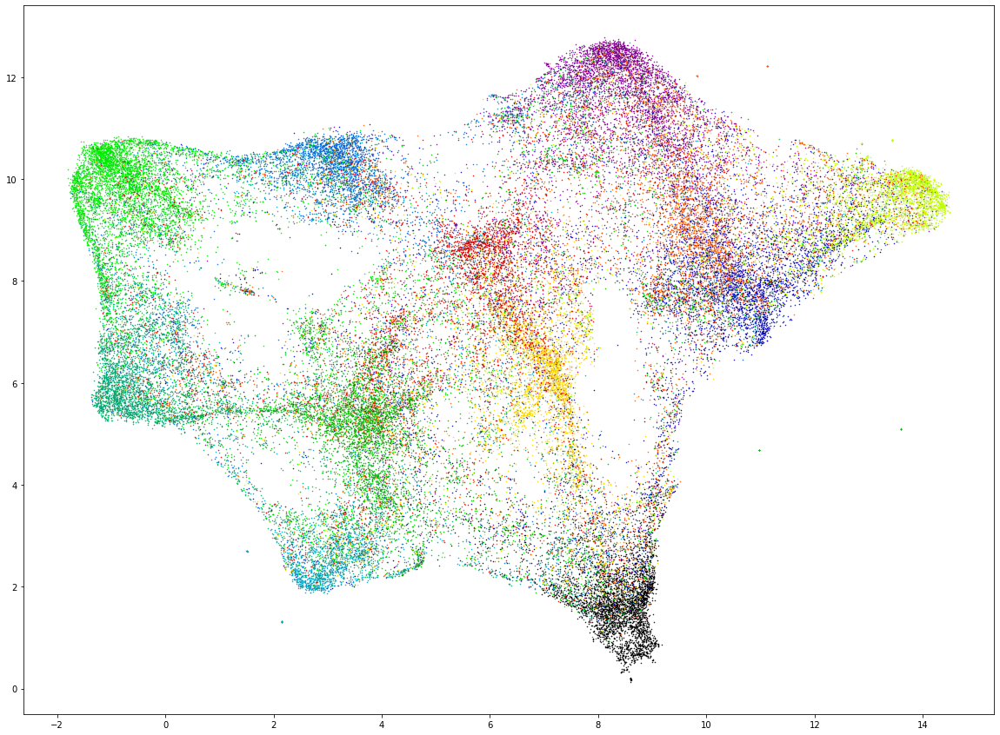

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.35086171977892067
INFO:PML:TRAINING EPOCH 12
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.44027: 100%|██████████| 1860/1860 [07:34<00:00,  4.10it/s]
INFO:PML:Evaluating epoch 12
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:06<00:00,  7.68it/s]
INFO:PML:R

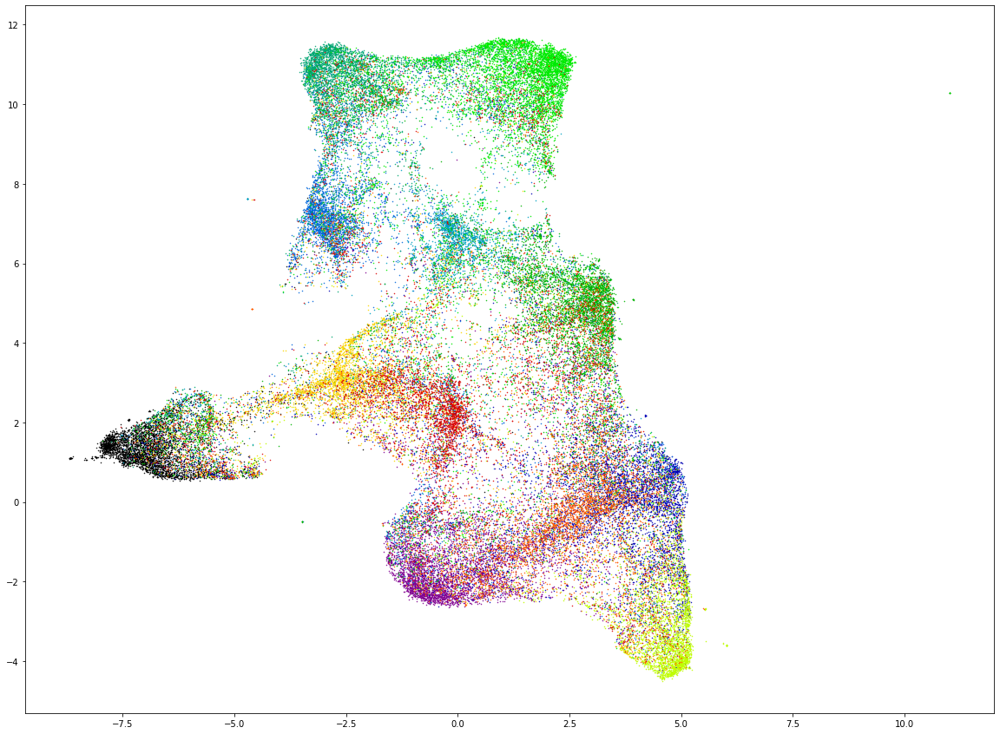

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.35914088980026065
INFO:PML:TRAINING EPOCH 13
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.90364: 100%|██████████| 1860/1860 [07:45<00:00,  3.99it/s]
INFO:PML:Evaluating epoch 13
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:08<00:00,  7.60it/s]
INFO:PML:R

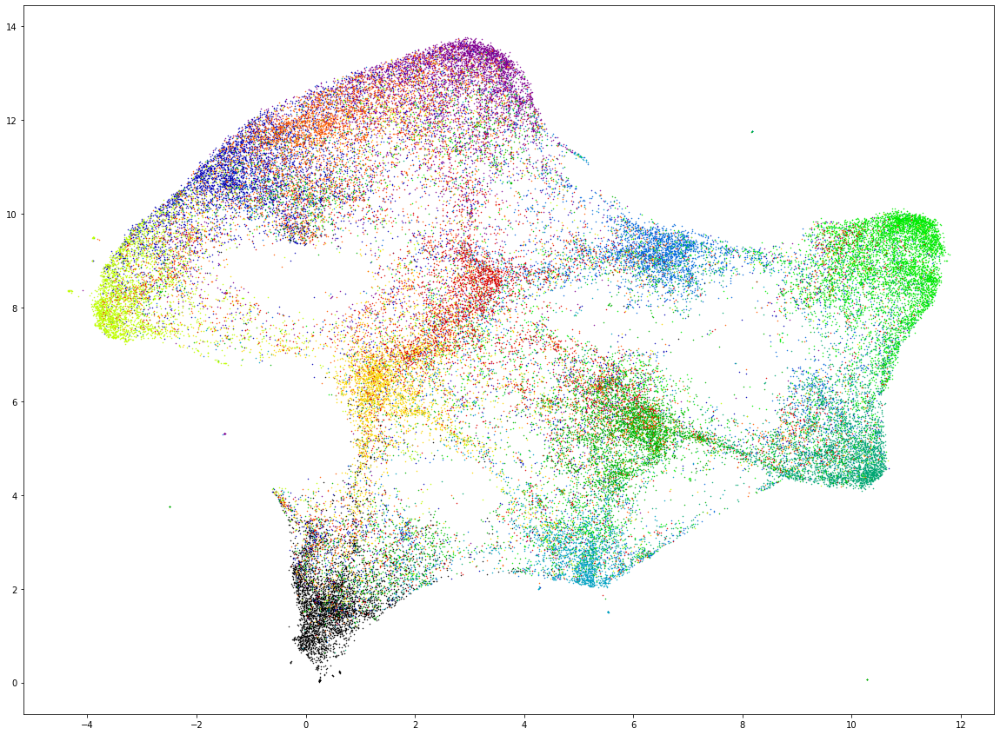

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.37052535228625916
INFO:PML:TRAINING EPOCH 14
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=7.48780: 100%|██████████| 1860/1860 [08:01<00:00,  3.87it/s]
INFO:PML:Evaluating epoch 14
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:18<00:00,  7.32it/s]
INFO:PML:R

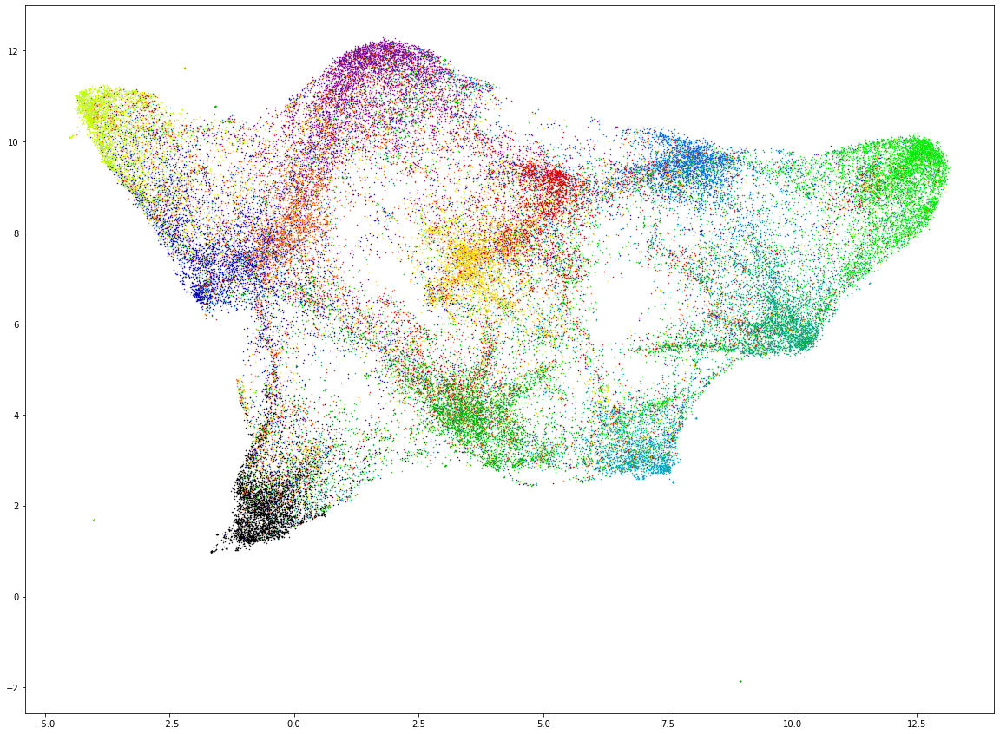

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3781089997758496
INFO:PML:TRAINING EPOCH 15
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.63430: 100%|██████████| 1860/1860 [08:25<00:00,  3.68it/s]
INFO:PML:Evaluating epoch 15
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:25<00:00,  7.13it/s]
INFO:PML:Ru

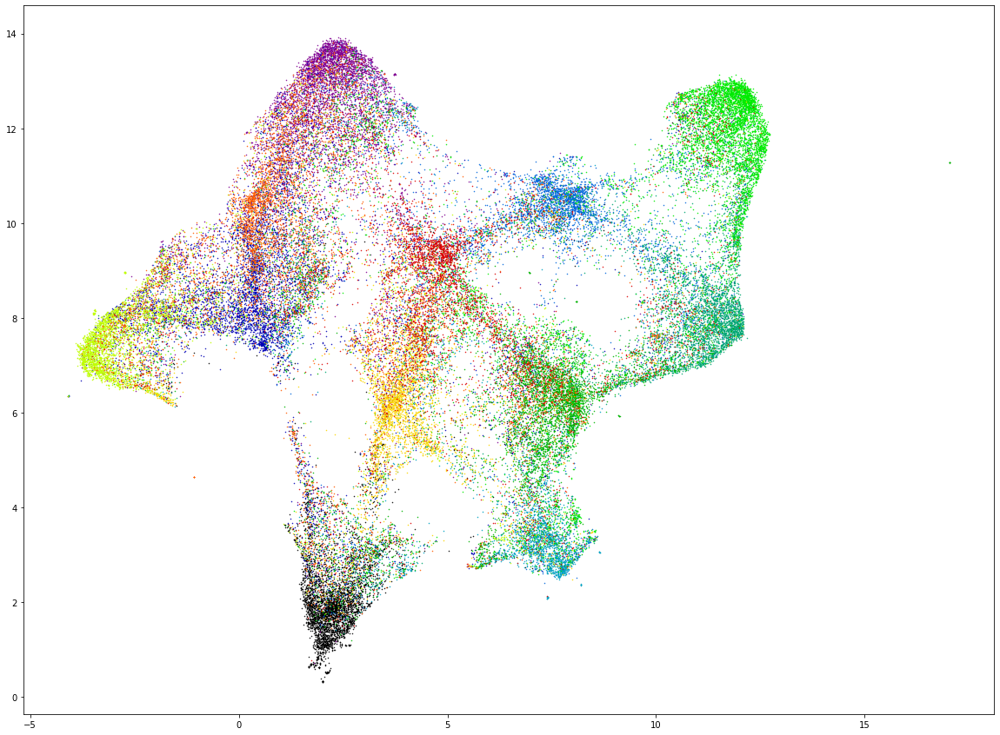

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:TRAINING EPOCH 16
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.63974: 100%|██████████| 1860/1860 [08:36<00:00,  3.60it/s]
INFO:PML:Evaluating epoch 16
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:32<00:00,  6.95it/s]
INFO:PML:Running UMAP on the val set
INFO:PML:Finished UMA

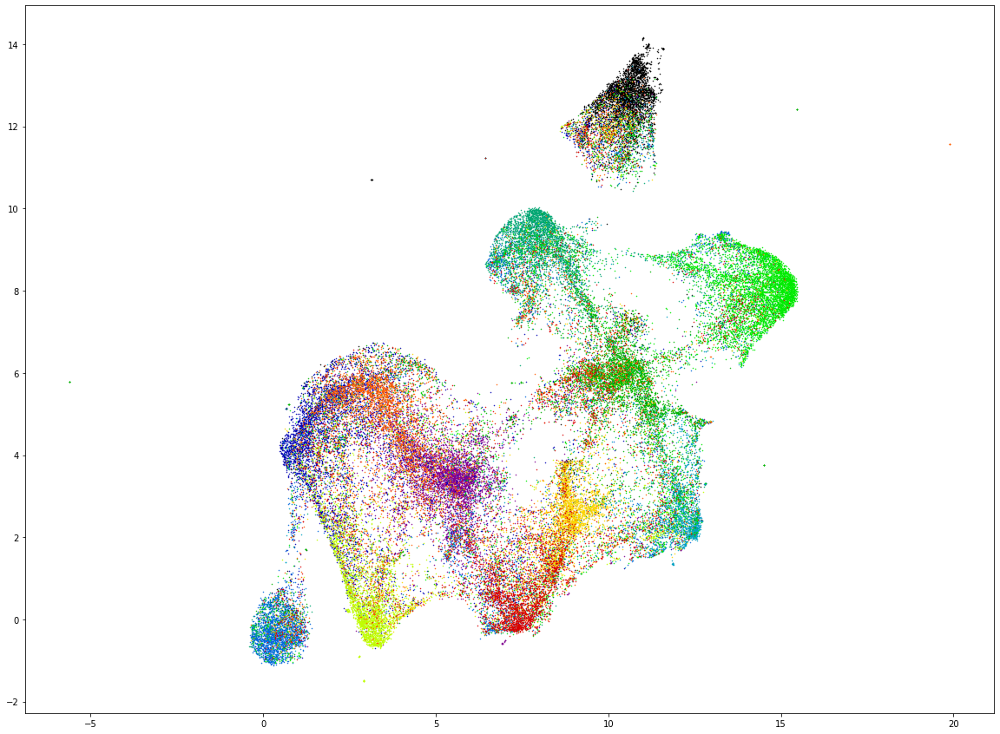

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3864143144572602
INFO:PML:TRAINING EPOCH 17
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=8.61669: 100%|██████████| 1860/1860 [08:42<00:00,  3.56it/s]
INFO:PML:Evaluating epoch 17
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [04:42<00:00,  6.68it/s]
INFO:PML:Ru

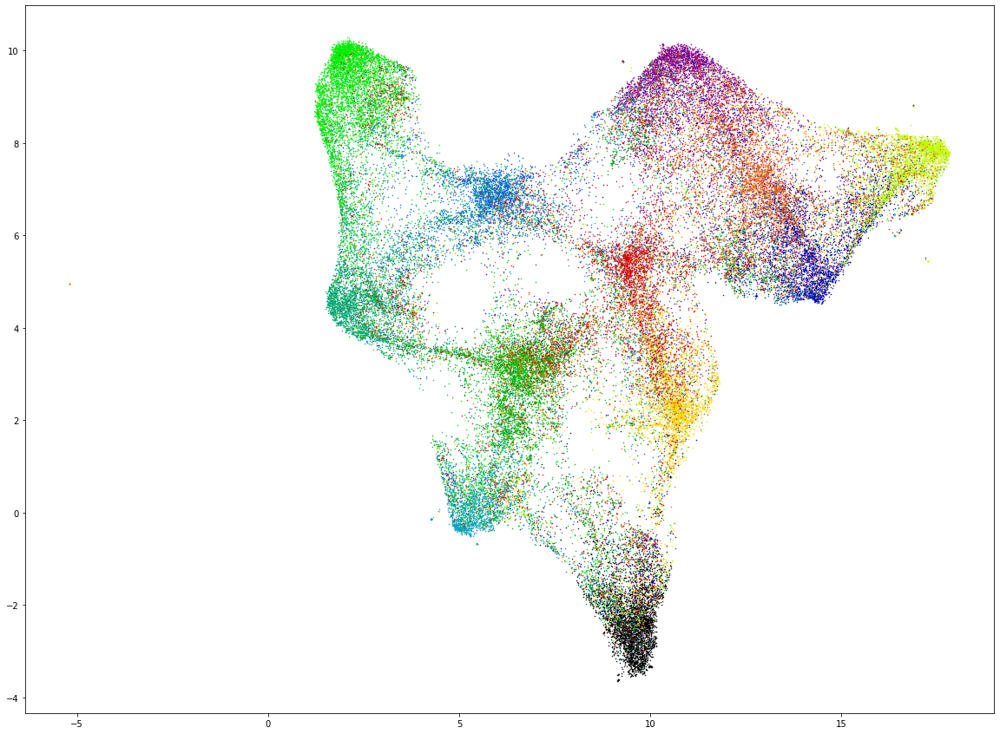

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3906418597193907
INFO:PML:TRAINING EPOCH 18
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.38571: 100%|██████████| 1860/1860 [08:24<00:00,  3.68it/s]
INFO:PML:Evaluating epoch 18
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:21<00:00,  5.89it/s]
INFO:PML:Ru

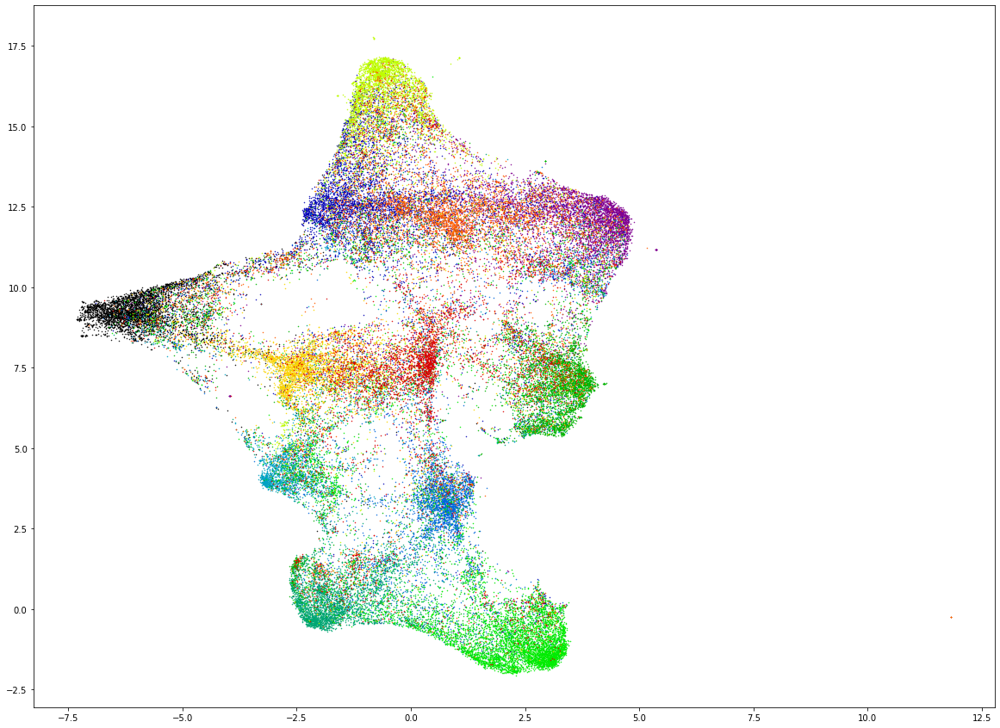

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.3985769824722393
INFO:PML:TRAINING EPOCH 19
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=9.83437: 100%|██████████| 1860/1860 [08:27<00:00,  3.66it/s]
INFO:PML:Evaluating epoch 19
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [05:54<00:00,  5.33it/s]
INFO:PML:Ru

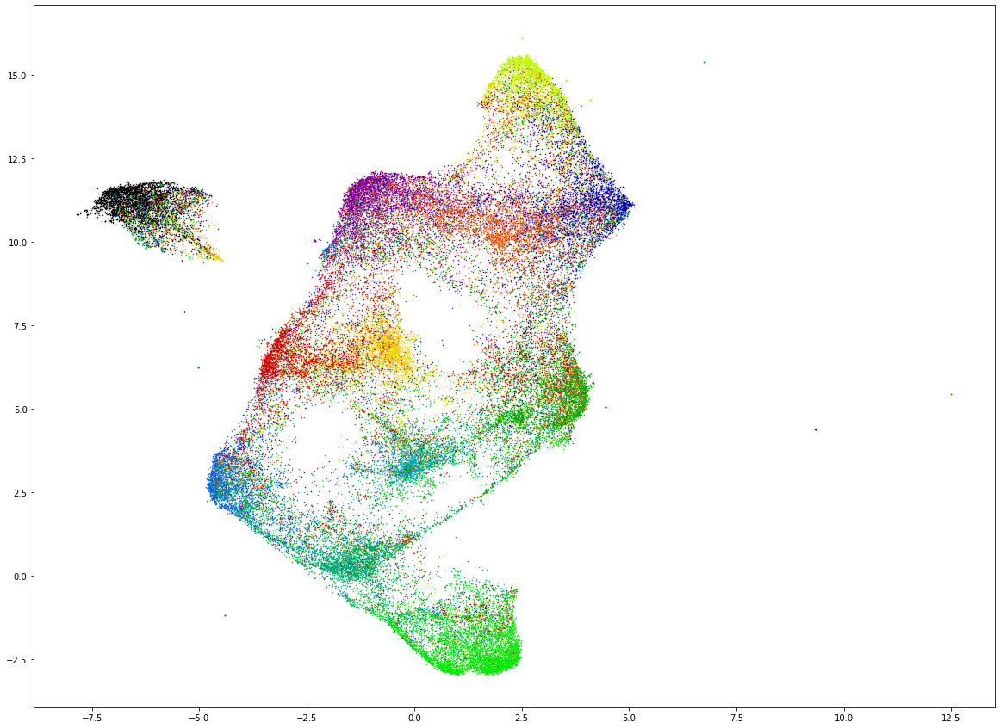

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.39935689803202
INFO:PML:TRAINING EPOCH 20
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=7.33343: 100%|██████████| 1860/1860 [08:39<00:00,  3.58it/s]
INFO:PML:Evaluating epoch 20
INFO:PML:Getting embeddings for the val split
100%|██████████| 1891/1891 [06:03<00:00,  5.20it/s]
INFO:PML:Runn

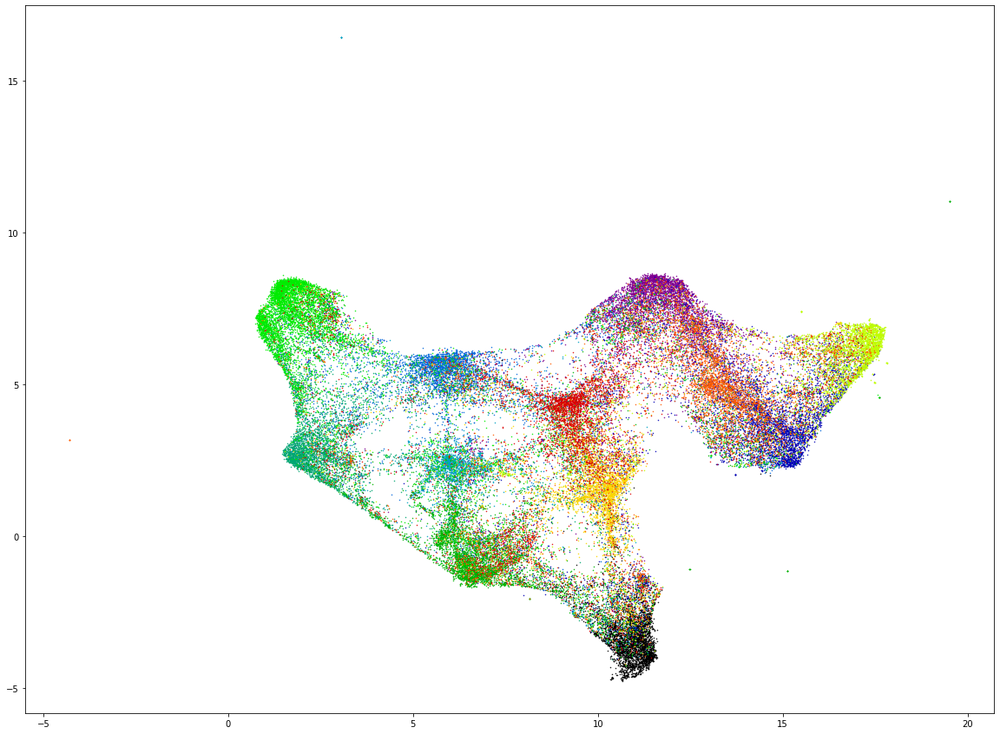

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:TRAINING EPOCH 21
  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
total_loss=10.57028:   4%|▎         | 66/1860 [00:32<11:27,  2.61it/s]

KeyboardInterrupt: ignored

In [12]:
trainer.train(num_epochs=num_epochs)

In [14]:
# epoch_count = 20
# fname1 = '/content/example_logs_' + str(epoch_count) + '.zip'
# fname2 = '/content/example_saved_models_' + str(epoch_count) + '.zip'
# fname3 = '/content/example_tensorboard_' + str(epoch_count) + '.zip'

!zip -r '/content/example_logs_20b.zip' example_logs
!zip -r '/content/example_saved_models_20b.zip' example_saved_models
!zip -r '/content/example_tensorboard_20b.zip' example_tensorboard 

!cp '/content/example_logs_20b.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss
!cp '/content/example_saved_models_20b.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss
!cp '/content/example_tensorboard_20b.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss

  adding: example_logs/ (stored 0%)
  adding: example_logs/loss_histories.csv (deflated 71%)
  adding: example_logs/logs.db (deflated 69%)
  adding: example_logs/metric_loss_LiftedStructureLoss_reducer_MeanReducer.csv (deflated 60%)
  adding: example_logs/metric_loss_LiftedStructureLoss_distance_LpDistance.csv (deflated 78%)
  adding: example_logs/loss_weights.csv (deflated 100%)
  adding: example_logs/trunk_optimizer_Adam.csv (deflated 100%)
  adding: example_logs/tuple_miner_MultiSimilarityMiner.csv (deflated 79%)
  adding: example_logs/accuracies_normalized_GlobalEmbeddingSpaceTester_level_0_VAL_vs_self.csv (deflated 54%)
  adding: example_logs/metric_loss_LiftedStructureLoss.csv (deflated 100%)
  adding: example_logs/embedder_optimizer_Adam.csv (deflated 100%)
  adding: example_saved_models/ (stored 0%)
  adding: example_saved_models/trunk_optimizer_20.pth (deflated 16%)
  adding: example_saved_models/embedder_optimizer_20.pth (deflated 9%)
  adding: example_saved_models/metric_los

INFO:PML:Initializing dataloader
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
INFO:PML:Initializing dataloader iterator
INFO:PML:Done creating dataloader iterator
INFO:PML:TRAINING EPOCH 1

total_loss=9.39387: 100%|██████████| 1860/1860 [06:04<00:00,  5.10it/s]
INFO:PML:Evaluating epoch 1
INFO:PML:Getting embeddings for the val split

100%|██████████| 1891/1891 [04:06<00:00,  7.66it/s]
INFO:PML:Running UMAP on the val set
INFO:PML:Finished UMAP
INFO:root:UMAP plot for the val split and label set UMAP_level0


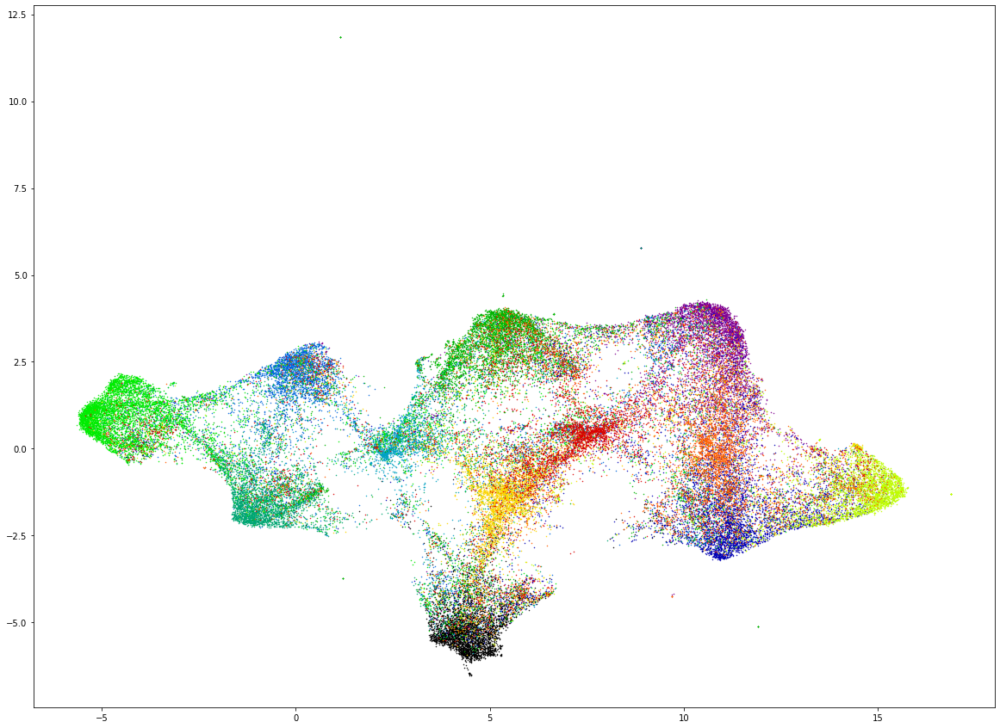

INFO:PML:Computing accuracy for the val split w.r.t ['val']
INFO:PML:running k-nn with k=601
INFO:PML:embedding dimensionality is 32
INFO:PML:running k-means clustering with k=12
INFO:PML:embedding dimensionality is 32
INFO:PML:New best accuracy! 0.4025328998729575
INFO:PML:TRAINING EPOCH 2

  0%|          | 0/1860 [00:00<?, ?it/s]/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:477: UserWarning: This DataLoader will create 32 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))

total_loss=9.83896:  61%|██████    | 1138/1860 [04:33<03:02,  3.96it/s]

KeyboardInterrupt: ignored

In [15]:
trainer.train(num_epochs = 20)

In [ ]:
!zip -r '/content/example_logs_40.zip' example_logs
!zip -r '/content/example_saved_models_40.zip' example_saved_models
!zip -r '/content/example_tensorboard_40.zip' example_tensorboard 

!cp '/content/example_logs_40.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss
!cp '/content/example_saved_models_40.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss
!cp '/content/example_tensorboard_40.zip' /content/gdrive/MyDrive/Stanford_Online_Products/model_datas/LiftedStructureLoss